In [1]:
import sys
sys.path.append('../src/')

In [2]:
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd
from unet import eval_preds

from fastai.vision import *
from fastai.callbacks import *
from fastai.script import *

from data_utils import *
from models import *
from learn_utils import *

from pathlib import Path
from torch import FloatTensor as FT

import plotly.express as px
from ipywidgets import FloatSlider, interactive

from scipy.ndimage import label

torch.cuda.set_device(6)

#  load images

In [3]:
# Read images
data_path = Path("/data/public/MIM_BMETS_V6/3_final_datasets/old/all_treatments_1.5x1.5x3_256x256x64")
trn_img = sorted(list(Path(data_path/"training/skull_stripped").iterdir()))
trn_mask = sorted(list(Path(data_path/"training/mets_masks").iterdir()))
valid_img = sorted(list(Path(data_path/"validation/skull_stripped").iterdir()))
valid_mask = sorted(list(Path(data_path/"validation/mets_masks").iterdir()))
test_img = sorted(list(Path(data_path/"testing/skull_stripped").iterdir()))
test_mask = sorted(list(Path(data_path/"testing/mets_masks").iterdir()))


print(f"Size of Train Dataset Images: {len(trn_img)} Images")
print(f"Size of Validation Dataset Images: {len(valid_img)} Images")
print(f"Size of Train Dataset Masks: {len(trn_mask)} Images")
print(f"Size of Validation Dataset Masks: {len(valid_mask)} Images")
print(f"Size of Test 1 Dataset Images: {len(test_img)} Images")
print(f"Size of Test 1 Dataset Masks: {len(test_mask)} Images")

Size of Train Dataset Images: 909 Images
Size of Validation Dataset Images: 192 Images
Size of Train Dataset Masks: 909 Images
Size of Validation Dataset Masks: 192 Images
Size of Test 1 Dataset Images: 198 Images
Size of Test 1 Dataset Masks: 198 Images


In [4]:
class MR_3D_Dataset(object):
    def __init__(self, images, ventricles, transform=None):
        self.images = images
        self.ventricles = ventricles
        self.transform = transform
    
    def __getitem__(self, index):
        image_voxel = np.load(self.images[index]).astype(np.float32)
        mask_voxel = np.load(self.ventricles[index]).astype(np.float32)
        if self.transform:
            image_voxel, mask_voxel = self.transform(image_voxel, mask_voxel)
        return FT(image_voxel[None,:]), FT(mask_voxel) 

    def __len__(self):
        return len(self.images)

train_ds = MR_3D_Dataset(trn_img, trn_mask)
valid_ds = MR_3D_Dataset(valid_img, valid_mask)   
test_ds = MR_3D_Dataset(test_img, test_mask)

bs=1
data = DataBunch.create(train_ds=train_ds, valid_ds=valid_ds, bs=1)
test_dl = DeviceDataLoader(DataLoader(test_ds, batch_size=bs), device=data.device)

# load model 

In [5]:
!ls '../model_training/ventricle/models/'

20191224_baseline_9.pth
20191224_mets_baseline_9.pth
best_of_20191231_Mets_first_tx_1met_simple_2.pth
best_of_20191231_Mets_first_tx_1met_simple.pth
best_of_20200101_first_tx_1met_simple_default.pth
best_of_20200102_first_tx_1met_simple_default.pth
best_of_20200113_first_tx_2mets_b9.pth
best_of_20200113_first_tx_3mets_b9.pth
best_of_Mets_Baseline_9_first_tx_1met.pth
best_of_Mets_Baseline_9_first_tx_1mets_2.pth
best_of_Mets_Baseline_9_first_tx_2mets.pth
best_of_Mets_Baseline_9_first_tx_3mets.pth
best_of_Mets_Baseline_9.pth
best_of_MR_Brain_Scratch_Baseline_9.pth


In [6]:
# Load model baseline11
model_name = 'baseline9'
f = experiment_model_dict[model_name]
m = f() 

loss_func = 'dice'
model_dir = '../model_training/ventricle/models/'
learn = Learner(data=data, model=m, callbacks=[], callback_fns=[], model_dir=model_dir)
learn.loss_func = {'dice':dice_loss, 'bce':BCEWithLogitsFlat(), 'mixed':None}[loss_func] 
learn.metrics = [dice_score]
learn.to_fp16();
learn.load('20191224_mets_baseline_9');

In [7]:
# get test1 predictions
learn.to_fp16();

# get test1 dice score and percent volume overlap
# def get_preds_targs(dl):
#     test_preds, test_targs = get_preds(learn.model, dl)
#     test_preds.squeeze_(1); test_preds.sigmoid_();
#     return test_preds, test_targs

#test_preds, test_targs = get_preds_targs(test_dl)
images, test_preds, test_masks = get_img_pred_masks(learn, test_dl)


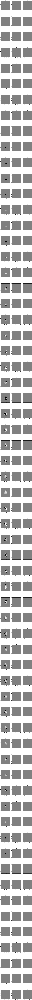

In [9]:
IMG_SET = 45
brainimgs = test_ds.__getitem__(IMG_SET)
#fig, ax = plt.subplots(55,2,figsize=(20,20))
#fig.set_size_inches(15,150)
plt.figure(figsize=(15, 500))
c = 1
for i in range(0,64):
    plt.subplot(64, 3, c)
    plt.imshow(brainimgs[0][0][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Image')
    c = c + 1
    plt.subplot(64, 3, c)
    plt.imshow(test_masks[IMG_SET][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Target')
    c = c + 1
    plt.subplot(64, 3, c)
    plt.imshow(test_preds[IMG_SET][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Pred')
    c = c + 1
   

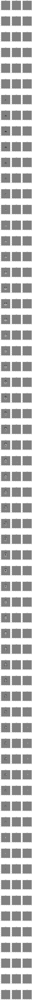

In [10]:
IMG_SET = 12
brainimgs = test_ds.__getitem__(IMG_SET)
#fig, ax = plt.subplots(55,2,figsize=(20,20))
#fig.set_size_inches(15,150)
plt.figure(figsize=(15, 500))
c = 1
for i in range(0,64):
    plt.subplot(64, 3, c)
    plt.imshow(brainimgs[0][0][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Image')
    c = c + 1
    plt.subplot(64, 3, c)
    plt.imshow(test_masks[IMG_SET][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Target')
    c = c + 1
    plt.subplot(64, 3, c)
    plt.imshow(test_preds[IMG_SET][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Pred')
    c = c + 1

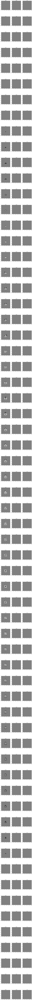

In [12]:
IMG_SET = 14
brainimgs = test_ds.__getitem__(IMG_SET)
#fig, ax = plt.subplots(55,2,figsize=(20,20))
#fig.set_size_inches(15,150)
plt.figure(figsize=(15, 500))
c = 1
for i in range(0,64):
    plt.subplot(64, 3, c)
    plt.imshow(brainimgs[0][0][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Image')
    c = c + 1
    plt.subplot(64, 3, c)
    plt.imshow(test_masks[IMG_SET][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Target')
    c = c + 1
    plt.subplot(64, 3, c)
    plt.imshow(test_preds[IMG_SET][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Pred')
    c = c + 1

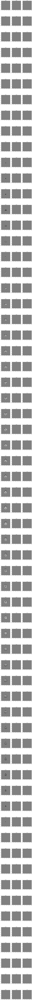

In [15]:
IMG_SET = 3
brainimgs = test_ds.__getitem__(IMG_SET)
#fig, ax = plt.subplots(55,2,figsize=(20,20))
#fig.set_size_inches(15,150)
plt.figure(figsize=(15, 500))
c = 1
for i in range(0,64):
    plt.subplot(64, 3, c)
    plt.imshow(brainimgs[0][0][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Image')
    c = c + 1
    plt.subplot(64, 3, c)
    plt.imshow(test_masks[IMG_SET][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Target')
    c = c + 1
    plt.subplot(64, 3, c)
    plt.imshow(test_preds[IMG_SET][i,:,:], cmap="gray", vmin=-1, vmax=1)
    plt.title('Pred')
    c = c + 1

In [ ]:
w = FloatSlider(value=32,min=0,max=63,step=1,description='Slice:')

def InteractiveReview(z):
    fig = px.imshow(test_masks[49][int(z)], color_continuous_scale='gray', zmin=0, zmax=5)
    fig.update_layout(height=400, width=600)
    fig.show()

In [8]:
interactive(InteractiveReview, z=w)

interactive(children=(FloatSlider(value=32.0, description='Slice:', max=63.0, step=1.0), Output()), _dom_class…

# Generate table and figures

In [8]:
def summary_table(target_masks, pred_masks, file_names):
    pred_dice_scores = [dice_score(pred_masks[i], target_masks[i]) for i in range(len(target_masks))]
    pred_percent_vol_diff = [vol_perc_diff(target_masks[i], pred_masks[i], True)*100 for i in range(len(target_masks))]
    TPs = [true_positive(pred_masks[i], target_masks[i]) for i in range(len(target_masks))]
    FPs = [false_positive(pred_masks[i], target_masks[i]) for i in range(len(target_masks))]
    target_mets = [label(target_masks[i]) for i in range(len(target_masks))]
    target_vols = [met_volume(target_mets[i][0],1.5*1.5*3) for i in range(len(file_names))]
    pred_mets = [label(pred_masks[i]) for i in range(len(target_masks))]
    target_num = [target_mets[i][1] for i in range(len(target_masks))] 
    pred_num = [pred_mets[i][1] for i in range(len(target_masks))] 
    d = {'test_name': file_names,
         'pred_dice_scores': pred_dice_scores, 
         'pred_percent_vol_diff': pred_percent_vol_diff,
         'target_mets': target_num,
         'target_vols (mm^3)': target_vols,
         'pred_mets': pred_num,
         'true_positive': TPs,
         'false_positive': FPs}
    df = pd.DataFrame(data=d)
    return df

def vol_perc_diff(mask, pred, absolute=False):
    #mask_vol = (((mask.numpy()).sum()).sum()).sum()
    #pred_vol = (((pred.numpy()).sum()).sum()).sum()
    mask_vol = ((mask.sum()).sum()).sum()
    pred_vol = ((pred.sum()).sum()).sum()
    if not absolute:
        return (pred_vol-mask_vol)/mask_vol
    return abs(pred_vol-mask_vol)/mask_vol

def dice_score(target, preds, thresh=0.5):
    iT = target#.numpy()
    iP = preds#.numpy()
    intersection = (((iT * iP).sum()).sum()).sum()
    return ((2.0 * intersection) / (((iT.sum()).sum()).sum() + ((iP.sum()).sum()).sum() + 1e-6))

def met_volume(image,res):
    numMets = np.amax(image)# max number
    metNum, counts = np.unique(image.flatten(), return_counts=True)
    return np.asarray(counts[1:]*res)

# True Positive (TP): we predict a label of 1 (positive), and the true label is 1.
def true_positive(true_labels, pred_labels):
    TP = np.logical_and(pred_labels == 1., true_labels == 1.).sum().sum().sum()
    return TP

# True Negative (TN): we predict a label of 0 (negative), and the true label is 0.
def true_negative(true_labels, pred_labels):
    TN = np.sum(np.logical_and(pred_labels == 0, true_labels == 0))
    return TN

# False Positive (FP): we predict a label of 1 (positive), but the true label is 0.
def false_positive(true_labels, pred_labels):
    FP = np.sum(np.logical_and(pred_labels == 1, true_labels == 0))
    return FP


In [10]:
names = []
data_path = data_path = Path("/data/public/MIM_BMETS_V6/3_final_datasets/old/all_treatments_1.5x1.5x3_256x256x64")
test1_img_files = sorted(list(Path(data_path/"testing/skull_stripped").iterdir()))
ok_names = [o.name for o in test1_img_files]
file_names = [fn for fn in test1_img_files if fn.name in ok_names]
for i in range(len(file_names)):
    names.append(str(file_names[i]).split("/")[-1].split("_")[0])

df = summary_table(test_masks, test_preds, names)
df_summary = df.describe()

df

,test_name,pred_dice_scores,pred_percent_vol_diff,target_mets,target_vols (mm^3),pred_mets,true_positive,false_positive
0,BrainMets-UCSF-00034,0.857732,9.269663,3,"[6122.25, 3071.25, 2821.5]",3,1456,324
1,BrainMets-UCSF-00058,0.752475,19.935170,6,"[121.5, 411.75, 891.0, 94.5, 2092.5, 553.5]",4,418,199
2,BrainMets-UCSF-00061,0.872489,3.250000,6,"[168.75, 148.5, 1964.25, 114.75, 479.25, 5224.5]",7,1064,136
3,BrainMets-UCSF-00098,0.861407,8.444444,3,"[229.5, 2760.75, 47.25]",3,404,46
4,BrainMets-UCSF-00104,0.803902,16.707768,1,[10948.5],3,1195,427
...,...,...,...,...,...,...,...,...
193,BrainMets-UCSF-01828,0.888031,4.166667,3,"[5123.25, 850.5, 20.25]",5,805,83
194,BrainMets-UCSF-01835,0.699874,39.148073,14,"[20.25, 94.5, 715.5, 47.25, 74.25, 1701.0, 223...",3,555,431
195,BrainMets-UCSF-01844,0.519481,0.000000,4,"[40.5, 189.0, 270.0, 20.25]",1,40,37
196,BrainMets-UCSF-01853,0.874687,18.871595,8,"[479.25, 621.0, 3368.25, 816.75, 256.5, 459.0,...",7,2443,641


In [ ]:
pd.set_option('display.max_rows', df.shape[0]+1)
df

In [17]:
indexes = df[df['pred_dice_scores']>0.9].index.tolist()
names = df['test_name'].tolist()
len(indexes)


['BrainMets-UCSF-00312',
 'BrainMets-UCSF-00788',
 'BrainMets-UCSF-01038',
 'BrainMets-UCSF-01074',
 'BrainMets-UCSF-01083',
 'BrainMets-UCSF-01183',
 'BrainMets-UCSF-01193',
 'BrainMets-UCSF-01271',
 'BrainMets-UCSF-01393',
 'BrainMets-UCSF-01409',
 'BrainMets-UCSF-01542',
 'BrainMets-UCSF-01556',
 'BrainMets-UCSF-01622',
 'BrainMets-UCSF-01630',
 'BrainMets-UCSF-01676',
 'BrainMets-UCSF-01678',
 'BrainMets-UCSF-01680',
 'BrainMets-UCSF-01681',
 'BrainMets-UCSF-01692',
 'BrainMets-UCSF-01703',
 'BrainMets-UCSF-01797',
 'BrainMets-UCSF-01798']

/usr/local/share/anaconda3/envs/ventricle/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



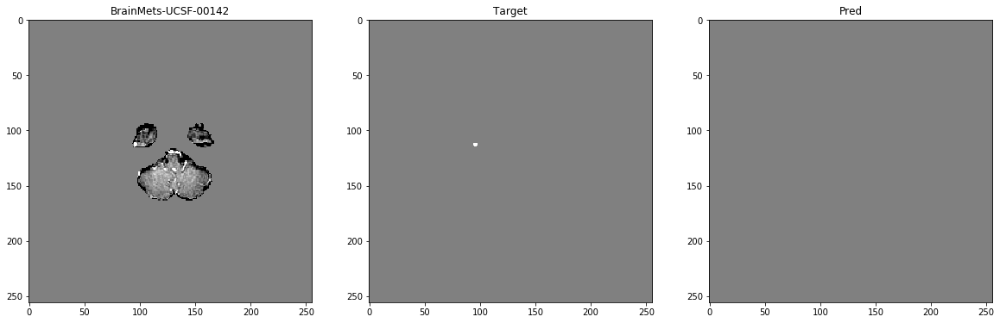

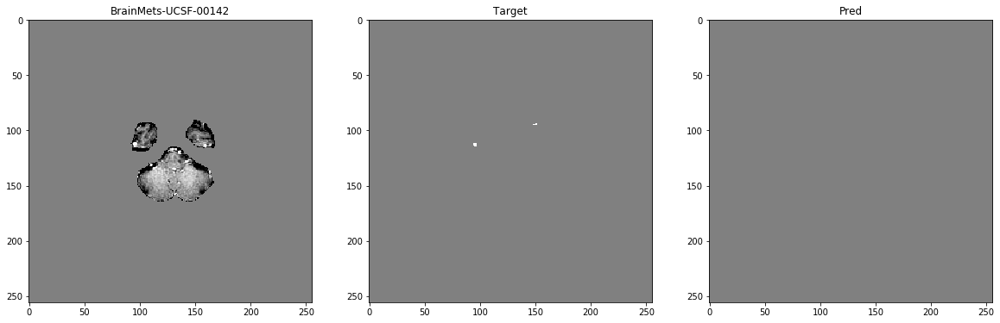

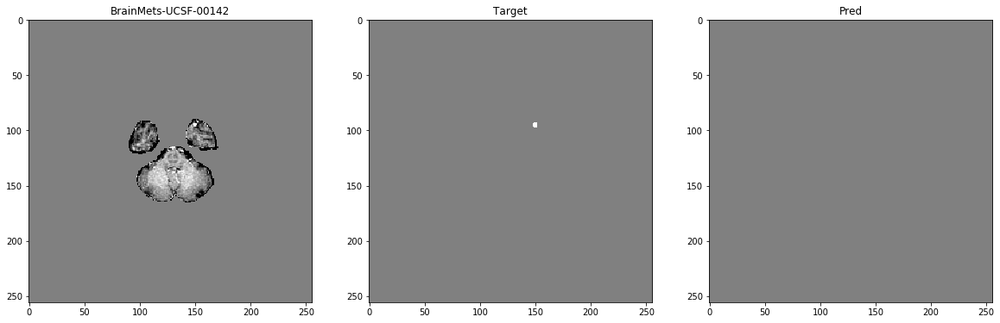

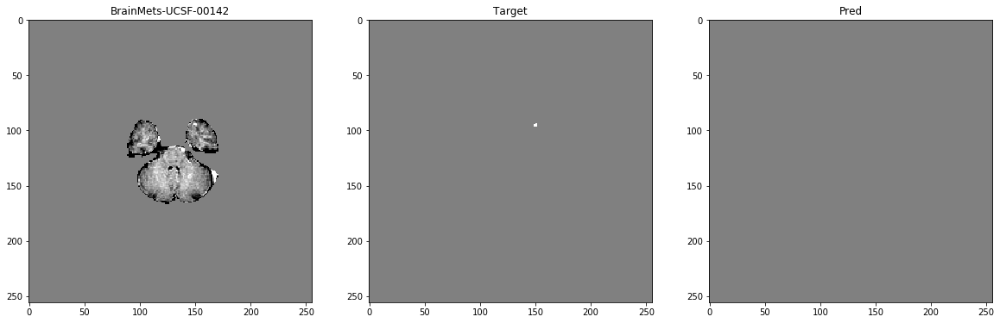

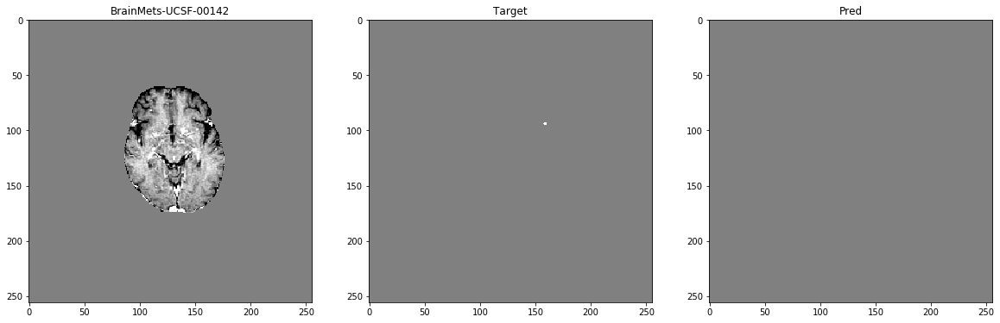

...

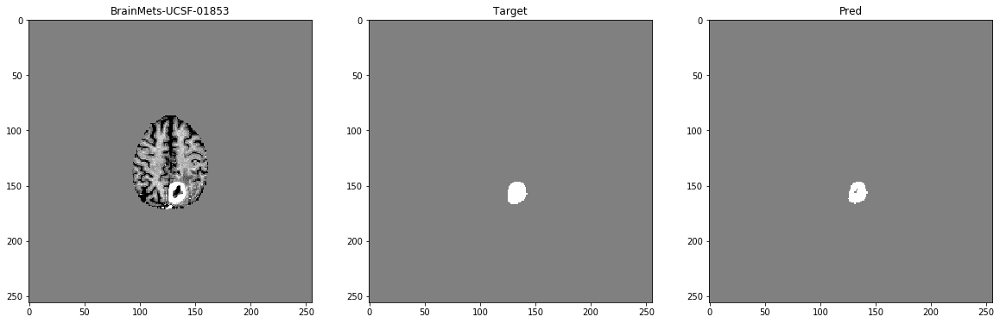

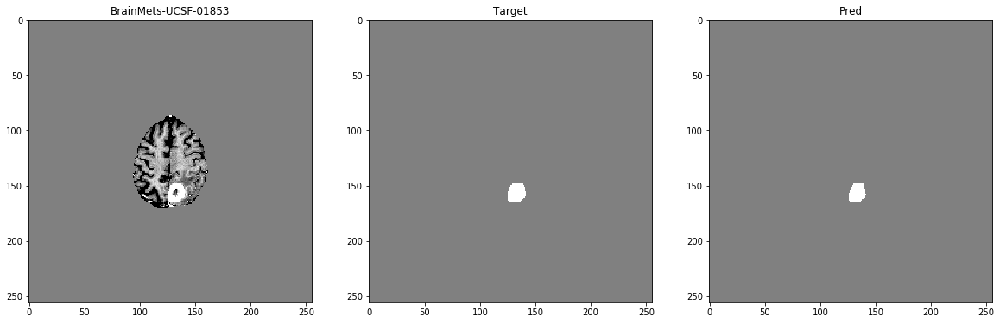

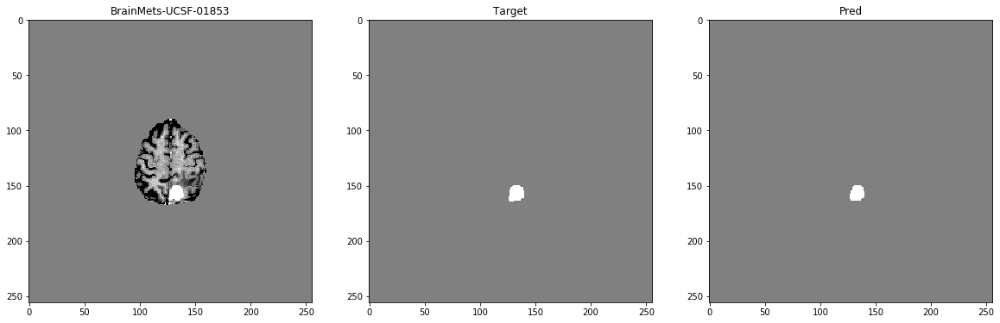

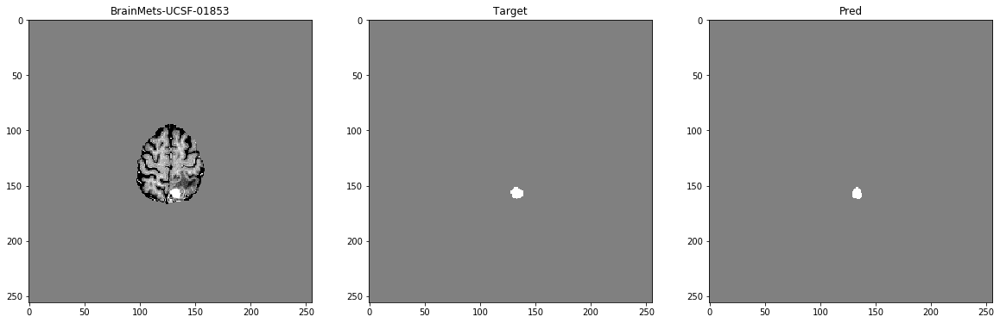

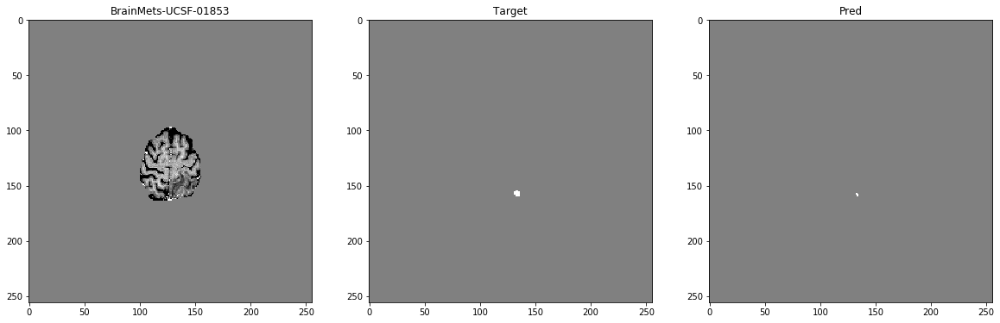

In [21]:
for i in indexes:
    for s in range(1,64):
        if sum(sum(test_masks[i][s,:,:])):
            fig = plt.figure(figsize=(20, 10))
            plt.subplot(1, 3, 1)
            plt.imshow(images[i][s,:,:], cmap="gray", vmin=-1, vmax=1)
            plt.title(names[i])
            plt.subplot(1, 3, 2)
            plt.imshow(test_masks[i][s,:,:], cmap="gray", vmin=-1, vmax=1)
            plt.title('Target')
            plt.subplot(1, 3, 3)
            plt.imshow(test_preds[i][s,:,:], cmap="gray", vmin=-1, vmax=1)
            plt.title('Pred')
            if names[i] == 'BrainMets-UCSF-01853': fig.savefig('tmp/' + names[i] + '_' + str(s) + '.png')


In [13]:
df2 = df
df2.drop(df2[df2['pred_dice_scores']==0.0].index, inplace=True)
df2.describe()

,pred_dice_scores,pred_percent_vol_diff,target_mets,pred_mets,true_positive,false_positive
count,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000
mean,0.809585,18.720118,1.068182,1.227273,519.681818,110.772727
std,0.184208,18.748101,0.333949,0.604773,542.767575,175.434194
min,0.085859,0.000000,1.000000,1.000000,15.000000,0.000000
25%,0.814834,5.766714,1.000000,1.000000,110.000000,14.750000
50%,0.864166,10.818713,1.000000,1.000000,398.000000,42.500000
75%,0.906168,26.725640,1.000000,1.000000,696.500000,134.750000
max,0.957770,90.573013,3.000000,4.000000,2570.000000,952.000000


In [14]:
df

,test_name,pred_dice_scores,pred_percent_vol_diff,target_mets,target_vols (mm^3),pred_mets,true_positive,false_positive
0,BrainMets-UCSF-00041,0.820779,30.538922,1,[1127.25],1,158,9
1,BrainMets-UCSF-00050,0.921890,0.576923,1,[3510.0],1,478,42
2,BrainMets-UCSF-00079,0.926569,2.894737,1,[5130.0],1,694,66
3,BrainMets-UCSF-00155,0.817518,44.642857,1,[378.0],2,56,0
4,BrainMets-UCSF-00244,0.684931,2.777778,1,[243.0],1,25,11
5,BrainMets-UCSF-00482,0.891204,18.734177,1,[2666.25],1,385,10
6,BrainMets-UCSF-00535,0.957770,0.000000,1,[11988.0],1,1701,75
7,BrainMets-UCSF-00583,0.814516,43.137255,1,[688.5],1,101,1
8,BrainMets-UCSF-00592,0.780488,20.854022,1,[6797.25],1,704,303
9,BrainMets-UCSF-00631,0.823770,34.615385,1,[5616.0],1,804,28


In [56]:
df.loc[100:150]

,test_name,pred_dice_scores,pred_percent_vol_diff
101,BrainMets-UCSF-01275,0.458678,68.953069
102,BrainMets-UCSF-01287,0.754373,39.242054
103,BrainMets-UCSF-01303,0.785838,25.733634
104,BrainMets-UCSF-01337,0.720000,65.957447
105,BrainMets-UCSF-01340,0.842809,9.090909
106,BrainMets-UCSF-01376,0.643545,30.666667
108,BrainMets-UCSF-01399,0.951523,4.282116
110,BrainMets-UCSF-01413,0.898042,8.151792
111,BrainMets-UCSF-01421,0.669020,15.171289
112,BrainMets-UCSF-01430,0.856895,27.865613


In [61]:
df.describe()

,pred_dice_scores,pred_percent_vol_diff,true_positive,false_positive
count,150.000000,150.000000,150.000000,150.000000
mean,0.650909,65.255009,595.626667,288.400000
std,0.271661,301.849092,635.596528,545.019697
min,0.000000,0.000000,0.000000,0.000000
25%,0.487649,8.906934,105.500000,45.250000
50%,0.766627,21.103499,374.500000,128.000000
75%,0.857645,53.109394,846.250000,302.250000
max,0.951523,3603.636364,2608.000000,4054.000000
